Metrics

In [2]:
# import geopandas as gpd
import numpy as np
import pandas as pd
import pygmt
# import matplotlib.pyplot as plt

def Gfit(obs, pred, t = 0.1): #a normalized least-squares using threshold t
    obs = np.array(obs)
    pred = np.array(pred)
    #set values below threshold to 0
    obs[obs < t] = 0
    pred[pred < t] = 0
    #calculate the G value
    Gvalue = 1 - (2*np.sum(obs*pred)/(np.sum(obs**2)+np.sum(pred**2)))
    return round(Gvalue, 3)

def AQC(obs, pred,t = 0.1): #Accuracy score based on threshold t
    obs = np.array(obs)
    pred = np.array(pred)
    #set values below threshold to 0
    obs[obs < t] = 0
    pred[pred < t] = 0
    #set values above threshold to 1
    obs[obs >= t] = 1
    pred[pred >= t] = 1
    #calculate the accuracy value
    aqc = np.sum(obs == pred)/len(obs)
    return round(aqc,3)

def Rsquared(obs, pred): #R-squared value
    obs = np.array(obs)
    pred = np.array(pred)
    #calculate the R-squared value
    Rsquared = 1 - (np.sum((obs - pred)**2)/np.sum((obs - np.mean(obs))**2))
    return round(Rsquared, 3)

def MSE(obs, pred): #Mean Squared Error
    obs = np.array(obs)
    pred = np.array(pred)
    #calculate the mean squared error
    mse = np.mean((obs - pred)**2)
    return round(mse, 3)
    
def L2Norm(obs): #L2 Norm
    obs = np.array(obs)
    #calculate the L2 norm
    L2norm = np.sqrt(np.sum(obs**2))
    return round(L2norm, 3)


Synthetic Events

RIKU


In [3]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def read_data(g, fold, epoch, region):
    idx_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_index_k{fold}.txt'
    run_idx = pd.read_csv(idx_path, header=None)[0]

    runno_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_runno_k{fold}.txt'
    run_no = pd.read_csv(runno_path, header=None)[0]

    predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_output/vae_riku_test_k{fold}_{epoch:04d}.npy'
    predict = np.load(predict_path)[:, -len(run_idx):, :, :]

    data_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_floodinputs.npy'
    data = np.load(data_path)
  
    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    
    basemap_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/fgmax{region:03d}_base.tif'

    return run_no, run_idx, predict, data, his_data, basemap_path

def plot_map(neve, run_no, run_idx, predict, data, gauge, basemap_file):
    # get 5 random events from run_no
    # event_sel = np.random.choice(run_no.values, neve, replace=False)
    event_sel= [ 12,  93, 319, 609 ,734]
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
        zooml = 12
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
        zooml = 10
    elif gauge == '3GaugeShio':
        west, south, east, north = (140.85,37.76,141.09,38.33)
        site = 'Sendai'
        subsize = ["10c","20c"]
        zooml = 5

    print('Events plotting are {}'.format(event_sel))

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t0.5c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "0.5c"],
        frame = ["ag"],
        ):
        # Plot each event
        for i in range(neve):
            event = event_sel[i]
            if event in run_no.values:
                idx0 = np.where(run_no == event)[0][0]
                idx = run_idx[idx0]
                
                # Get data for the event
                eve_data = data[idx].squeeze()
                mean = np.mean(predict[:, run_no == event], axis=0).squeeze()
                std2 = 2 * np.std(predict[:, run_no == event], axis=0).squeeze()
                colorend = max(eve_data.max(), mean.max())
                mask = ((eve_data > 0.1) | (mean > 0.1))
                
                # Plot observed data
                with fig.set_panel(panel=[i,0]):
                    pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                    para = eve_data 
                    print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                                frame = ["+tEvent(A) {}".format(event)] if event  < 595 else ["+tEvent(B) {}".format(event-595)],
                            )
                    fig.plot(x=his_data['Lon'][para>0.1],
                             y=his_data['Lat'][para>0.1],
                             fill=para[para>0.1],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/1.5c+h")

                with fig.set_panel(panel=[i,1]):
                    pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                    para = mean
                    print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][para>0.1],
                             y=his_data['Lat'][para>0.1],
                             fill=para[para>0.1],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/1.5c+h")

                with fig.set_panel(panel=[i,2]):
                    para = eve_data - mean
                    print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/1.5c+h")
                    fig.text(position='TC',offset= "j0c/2c", justify="CT",
                            text=f'G: {Gfit(eve_data, mean):.3f}, A: {AQC(eve_data, mean):.2f}',
                            font="25p,Helvetica-Bold,Yellow")

                with fig.set_panel(panel=[i,3]):
                    para = eve_data - mean - std2
                    print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/1.5c+h")
                    fig.text(position='TC',offset= "j0c/2c", justify="CT",
                            text=f'G: {Gfit(eve_data, mean - std2):.3f}, A: {AQC(eve_data, mean - std2):.2f}',
                            font="25p,Helvetica-Bold,Yellow")

                with fig.set_panel(panel=[i,4]):
                    para = eve_data - mean + std2
                    print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10])
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             )
                    fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/1.5c+h")
                    fig.text(position='TC',offset= "j0c/2c", justify="CT",
                            text=f'G: {Gfit(eve_data, mean + std2):.3f}, A: {AQC(eve_data, mean + std2):.2f}',
                            font="25p,Helvetica-Bold,Yellow")
                 
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
epoch_list = [0, 0, 0]
fold = 0
neve = 5

for n, g in enumerate(g_list[0:1]):
    run_no, run_idx, predict, data, his_data, basemap_file = read_data(g, fold, epoch_list[n], 3 - n)
    plot_map(neve, run_no, run_idx, predict, data, g, basemap_file)


Events plotting are [12, 93, 319, 609, 734]
range of observed data is max 0.52409 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 0.8236933994293213 min -0.19173792235553264


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 0.19173792235553264 min -0.4170742228341103


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 0.058714944753113896 min -0.5732438620308251


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 0.3301817099939478 min -0.27496436021290777


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of observed data is max 0.53012 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 0.7714728754758835 min -0.20858545877039433


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 0.20858545877039433 min -0.3735240125656128


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 0.06443200247513947 min -0.5358812387217047


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 0.3527389150656492 min -0.2111667864095209


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of observed data is max 1.63496 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 1.4827359437942504 min -0.08439288035966457


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 0.3635585000514985 min -0.5575874352455139


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 0.19375755489188867 min -0.7006208222992854


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 0.5333594452111083 min -0.4247963991846153


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of observed data is max 10.62625 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 10.838931913375854 min -0.36288765698671344


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 1.5368543881130217 min -1.0373217207145689


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 1.3991082142111442 min -1.1247721321961754


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 1.6746005620148992 min -0.9498713092329621


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of observed data is max 9.20216 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 9.492621927261352 min -0.3475993674993515


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 0.6738143360137938 min -1.2554669012832642


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 0.5993848545946807 min -1.3564474341221908


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 0.7482438174329069 min -1.1544863684443376


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


ISHI

In [4]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def read_data(g, fold, epoch, region):
    idx_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_index_k{fold}.txt'
    run_idx = pd.read_csv(idx_path, header=None)[0]

    runno_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_runno_k{fold}.txt'
    run_no = pd.read_csv(runno_path, header=None)[0]

    predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_output/vae_riku_test_k{fold}_{epoch:04d}.npy'
    predict = np.load(predict_path)[:, -len(run_idx):, :, :]

    data_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_floodinputs.npy'
    data = np.load(data_path)
  
    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    
    basemap_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/fgmax{region:03d}_base.tif'

    return run_no, run_idx, predict, data, his_data, basemap_path

def plot_map(neve, run_no, run_idx, predict, data, gauge, basemap_file):
    # get 5 random events from run_no
    # event_sel = np.random.choice(run_no.values, neve, replace=False)
    event_sel= [697, 136, 357 ,323 ,682]
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
        zooml = 12
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
        zooml = 10
    elif gauge == '3GaugeShio':
        west, south, east, north = (140.85,37.76,141.09,38.33)
        site = 'Sendai'
        subsize = ["10c","20c"]
        zooml = 5

    print('Events plotting are {}'.format(event_sel))

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t0.5c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "1.5c"],
        frame = ["ag"],
        ):
        # Plot each event
        for i in range(neve):
            event = event_sel[i]
            if event in run_no.values:
                idx0 = np.where(run_no == event)[0][0]
                idx = run_idx[idx0]
                
                # Get data for the event
                eve_data = data[idx].squeeze()
                mean = np.mean(predict[:, run_no == event], axis=0).squeeze()
                std2 = 2 * np.std(predict[:, run_no == event], axis=0).squeeze()
                colorend = max(eve_data.max(), mean.max())
                mask = ((eve_data > 0.1) | (mean > 0.1))

                
                # Plot observed data
                with fig.set_panel(panel=[i,0]):
                    pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                    para = eve_data 
                    print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                                frame = ["+tEvent(A) {}".format(event)] if event  < 595 else ["+tEvent(B) {}".format(event-595)],
                            
                            )
                    fig.plot(x=his_data['Lon'][para>0.1],
                             y=his_data['Lat'][para>0.1],
                             fill=para[para>0.1],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/1c+h")

                with fig.set_panel(panel=[i,1]):
                    pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                    para = mean
                    print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][para>0.1],
                             y=his_data['Lat'][para>0.1],
                             fill=para[para>0.1],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/1c+h")

                with fig.set_panel(panel=[i,2]):
                    para = eve_data - mean
                    print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/1c+h")
                    fig.text(position='BC',offset= "j0c/1c", justify="CB",
                            text=f'G: {Gfit(eve_data, mean):.3f}, A: {AQC(eve_data, mean):.2f}',
                            font="25p,Helvetica-Bold,Yellow")
                            
                with fig.set_panel(panel=[i,3]):
                    para = eve_data - mean - std2
                    print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             ) 
                    fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/1c+h")
                    fig.text(position='BC',offset= "j0c/1c", justify="CB",
                            text=f'G: {Gfit(eve_data, mean - std2):.3f}, A: {AQC(eve_data, mean - std2):.2f}',
                            font="25p,Helvetica-Bold,Yellow")
                    
                with fig.set_panel(panel=[i,4]):
                    para = eve_data - mean + std2
                    print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M12c",
                                zoom=12,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.15c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M12c",
                             )
                    fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/1c+h")
                    fig.text(position='BC',offset= "j0c/1c", justify="CB",
                            text=f'G: {Gfit(eve_data, mean + std2):.3f}, A: {AQC(eve_data, mean + std2):.2f}',
                            font="25p,Helvetica-Bold,Yellow")
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
epoch_list = [0, 0, 0]
fold = 0
neve = 5

for n, g in enumerate(g_list[1:2]):
    run_no, run_idx, predict, data, his_data, basemap_file = read_data(g, fold, epoch_list[n], 2)
    plot_map(neve, run_no, run_idx, predict, data, g, basemap_file)

Events plotting are [697, 136, 357, 323, 682]
range of observed data is max 12.26591 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 11.553877592086792 min -0.0761968307569623


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 1.305324272956848 min -0.7595341433715816


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 1.198815003536811 min -0.8210195831311309


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 1.4118335423768849 min -0.6980487036120324


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of observed data is max 1.59408 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 1.2421620619297027 min -0.25377965465188024


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 0.4921221806812286 min -0.31265400780797004


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 0.4125423514921548 min -0.46572806818366386


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 0.5717020098703024 min -0.1913195655324959


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of observed data is max 7.13092 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 7.20470458984375 min -0.07011772145051509


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 0.9744905712127685 min -0.9982803332805633


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 0.9082929902814489 min -1.017808489565158


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 1.040688152144088 min -0.9787521769959686


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of observed data is max 4.69139 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 3.925465805530548 min -0.3847729228436947


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 1.1764725014448167 min -0.5758117143535615


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 1.1154448632734435 min -0.7340993450639179


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 1.23750013961619 min -0.4605767903137531


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of observed data is max 12.52856 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 11.284339513778686 min -0.16511355429887772


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 4.358839359483719 min -0.7374890191936493


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 4.320504899836005 min -0.7898977796368288


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 4.3971738191314325 min -0.6850802587504697


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


Sendai

Events plotting are [347, 691]
range of observed data is max 6.90201 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean predicted data is max 6.762393865585327 min -0.13172852307558058


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean misfit is max 1.1950984778022766 min -0.856002523303032


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of -2std misfit is max 1.1148367757294106 min -0.9030454525781052


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of +2std misfit is max 1.2753601798751426 min -0.8089595940279587


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of observed data is max 12.71831 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean predicted data is max 12.658845348358154 min -0.1816606305539608


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean misfit is max 2.2826289270019533 min -2.5992107878494264


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of -2std misfit is max 2.19901812649881 min -2.65831002396972


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of +2std misfit is max 2.366239727505097 min -2.5401115517291326


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


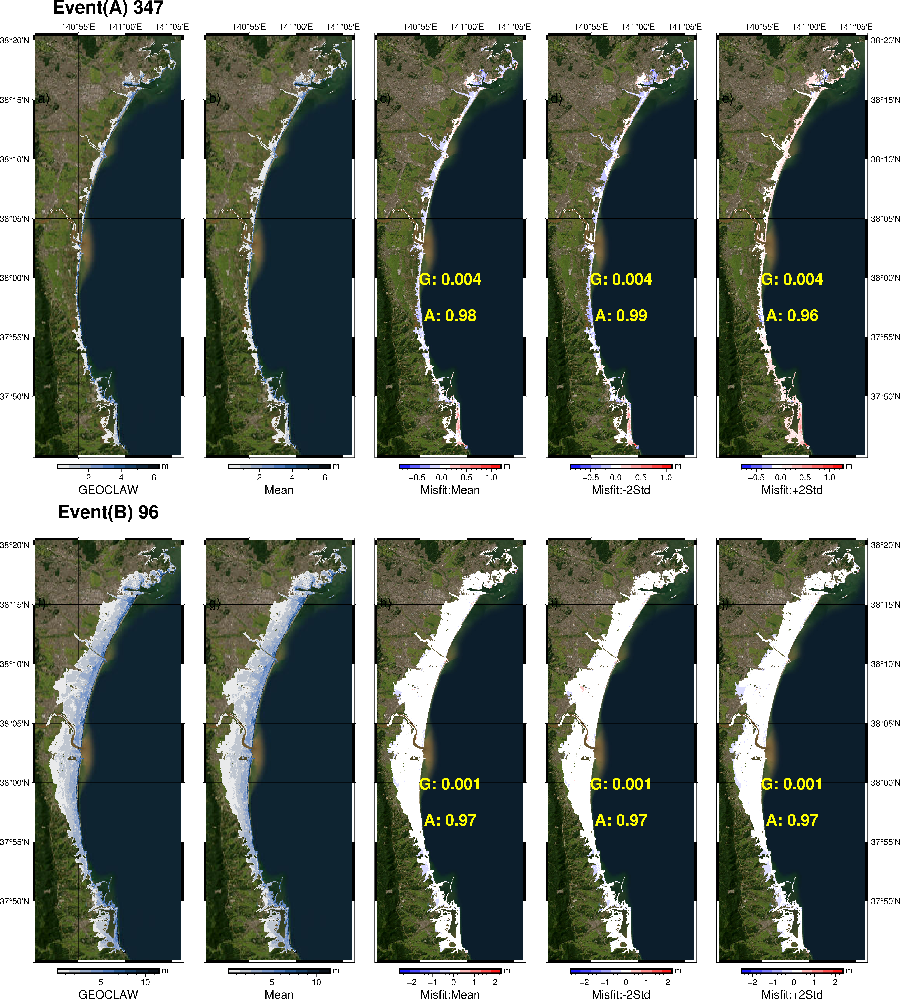

In [3]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def read_data(g, fold, epoch, region):
    idx_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_index_k{fold}.txt'
    run_idx = pd.read_csv(idx_path, header=None)[0]

    runno_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_runno_k{fold}.txt'
    run_no = pd.read_csv(runno_path, header=None)[0]

    predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_output/vae_riku_test_k{fold}_{epoch:04d}.npy'
    predict = np.load(predict_path)[:, -len(run_idx):, :, :]

    data_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_floodinputs.npy'
    data = np.load(data_path)
  
    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    
    basemap_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/fgmax{region:03d}_base.tif'

    return run_no, run_idx, predict, data, his_data, basemap_path

def plot_map(neve, run_no, run_idx, predict, data, gauge, basemap_file):
    # get 5 random events from run_no
    # event_sel = np.random.choice(run_no.values, neve, replace=False)
    event_sel= [347,691]
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
    elif gauge == '3GaugeShio':
        west, south, east, north = (140.85,37.76,141.09,38.33)
        site = 'Sendai'
        subsize = ["8c","20c"]

    print('Events plotting are {}'.format(event_sel))

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t0.5c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "3c"],
        frame = ["ag"],
        ):
        # Plot each event
        for i in range(neve):
            event = event_sel[i]
            if event in run_no.values:
                idx0 = np.where(run_no == event)[0][0]
                idx = run_idx[idx0]
                
                # Get data for the event
                eve_data = data[idx].squeeze()
                mean = np.mean(predict[:, run_no == event], axis=0).squeeze()
                std2 = 2 * np.std(predict[:, run_no == event], axis=0).squeeze()
                colorend = max(eve_data.max(), mean.max())
                mask = ((eve_data > 0.1) | (mean > 0.1))
                
                # Plot observed data
                with fig.set_panel(panel=[i,0]):
                    pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                    para = eve_data 
                    print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                    fig.tilemap(
                                region=region,
                                projection="M8c",
                                zoom=10,
                                source=cx.providers.Esri.WorldImagery,
                                frame = ["+tEvent(A) {}".format(event)] if event  < 595 else ["+tEvent(B) {}".format(event-595)],
                            
                            )
                    fig.plot(x=his_data['Lon'][para>0.1],
                             y=his_data['Lat'][para>0.1],
                             fill=para[para>0.1],
                             style='s0.05c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M8c",
                             ) 
                    fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/0.5c+h")

                with fig.set_panel(panel=[i,1]):
                    pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                    para = mean
                    print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                    fig.tilemap(
                                region=region,
                                projection="M8c",
                                zoom=10,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][para>0.1],
                             y=his_data['Lat'][para>0.1],
                             fill=para[para>0.1],
                             style='s0.05c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M8c",
                             ) 
                    fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/0.5c+h")

                with fig.set_panel(panel=[i,2]):
                    para = eve_data - mean
                    print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M8c",
                                zoom=11,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.05c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M8c",
                             ) 
                    fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/0.5c+h")
                    fig.text(position='TC',offset= "j4c/10c", justify='CT',
                            text=f'G: {Gfit(eve_data, mean):.3f}',
                            font="25p,Helvetica-Bold,Yellow")
                    fig.text(position='TC',offset= "j4c/12c", justify='CT',
                            text=f'A: {AQC(eve_data, mean):.2f}',
                            font="25p,Helvetica-Bold,Yellow")
                      
                with fig.set_panel(panel=[i,3]):
                    para = eve_data - mean - std2
                    print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M8c",
                                zoom=11,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.05c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M8c",
                             ) 
                    fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                    fig.text(position='TC',offset= "j4c/10c", justify='CT',
                            text=f'G: {Gfit(eve_data, mean - std2):.3f}',
                            font="25p,Helvetica-Bold,Yellow")
                    fig.text(position='TC',offset= "j4c/12c", justify='CT',
                            text=f'A: {AQC(eve_data, mean - std2):.2f}',
                            font="25p,Helvetica-Bold,Yellow")
                    
                with fig.set_panel(panel=[i,4]):
                    para = eve_data - mean + std2
                    print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                    pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                    fig.tilemap(
                                region=region,
                                projection="M8c",
                                zoom=11,
                                source=cx.providers.Esri.WorldImagery,
                            )
                    fig.plot(x=his_data['Lon'][mask],
                             y=his_data['Lat'][mask],
                             fill=para[mask],
                             style='s0.05c',
                             cmap = True,
                             transparency =50,
                             region = region,
                             projection="M8c",
                             )
                    fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                    fig.text(position='TC',offset= "j4c/10c", justify='CT',
                            text=f'G: {Gfit(eve_data, mean + std2):.3f}',
                            font="25p,Helvetica-Bold,Yellow")
                    fig.text(position='TC',offset= "j4c/12c", justify='CT',
                            text=f'A: {AQC(eve_data, mean + std2):.2f}',
                            font="25p,Helvetica-Bold,Yellow")
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
epoch_list = [0, 0, 0]
fold = 0
neve = 2

for n, g in enumerate(g_list[2:3]):
    run_no, run_idx, predict, data, his_data, basemap_file = read_data(g, fold, epoch_list[n], 1 - n)
    plot_map(neve, run_no, run_idx, predict, data, g, basemap_file)


Performance stats

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def read_data(g, fold, epoch, region):
    idx_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_index_k{fold}.txt'
    run_idx = pd.read_csv(idx_path, header=None)[0]

    runno_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_test_runno_k{fold}.txt'
    run_no = pd.read_csv(runno_path, header=None)[0]

    predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_output/vae_riku_test_k{fold}_{epoch:04d}.npy'
    predict = np.load(predict_path)[:, -len(run_idx):, :, :]

    data_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{g}/_data/riku_floodinputs.npy'
    data = np.load(data_path)    
    
    return run_no, run_idx, predict, data

def calc_stat(gauge,epoch,reg):
#empty table
    stat = pd.DataFrame(columns=['ID','G', 'R2', 'MSE', 'L2Norm'])   
    fold = [0,1,2,3,4]
    if gauge == '1GaugeRiku':
        Site = 'Rikuzentakata'
    elif gauge == '3GaugeIshi':
        Site = 'Ishinomaki'
    elif gauge == '3GaugeShio':
        Site = 'Sendai'
    for f in fold:#0-4
        print('fold {}'.format(f))
        run_no, run_idx, predict, data = read_data(g, f,epoch,reg)   
        obs_test = data[run_idx]
        for e in range(predict.shape[1]): #0-98ish 
            eve_data = obs_test[e, -1, :] # 0 is input and -1 is output
            for p in range(predict.shape[0]): #0-99 
                pred = predict[p, e,:,:].squeeze()
                stat = pd.concat([stat, pd.DataFrame({'ID': run_no[e],
                                                    'Fold': f,
                                                    'Site': Site,
                                                    'Type':'MAP',
                                                    'G': Gfit(eve_data, pred),
                                                    'R2': Rsquared(eve_data, pred),
                                                    'MSE': MSE(eve_data, pred),
                                                    'L2Norm': L2Norm(eve_data)}, index=[0])], ignore_index=True)               
    #plot last 
    # plt.plot(eve_data, label='obs', linestyle='--', color='grey', linewidth=1)
    # plt.plot(pred, label='pred', color='green', linewidth=1,alpha=0.65)
    # plt.show()
    #save to csv
    stat.to_csv('/mnt/beegfs/nragu/tsunami/japan/Paper/_results/Perf_test_depths_{}.csv'.format(Site),index=False)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
epoch_list = [0, 0, 0]

for n,g in enumerate(g_list):
    calc_stat(g,epoch_list[n],3 - n)